# Style Transfer using GAN

To build a Generative adversarial model(modified U-Net) which can generate artificial MRI images of different contrast levels from existing MRI scans.

In [1]:
# Hardware Accelerator
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Mon Jun 12 04:29:06 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   39C    P0    26W / 300W |      0MiB / 16384MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
#Import essential libraries
import pathlib
import os

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.preprocessing.image import img_to_array, load_img

## Loading Images

In [3]:
# Comment this cell if running locally
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
# Replace the value to './' if running locally
base_path = '/content/drive/My Drive/Datasets/'

In [5]:
# Defining the path for T1 & T2 datasets
t1_dir = base_path + "MRI T1 T2 Dataset/Tr1/TrainT1/"
t2_dir = base_path + "MRI T1 T2 Dataset/Tr2/TrainT2/"

In [6]:
t1_images = sorted(os.listdir(t1_dir), key=lambda x: int(x.split('#')[1].split('.')[0]))
t2_images = sorted(os.listdir(t2_dir), key=lambda x: int(x.split('#')[1].split('.')[0]))

In [7]:
# Removing problematic images
t2_images.remove('Image #80.png')
t2_images.remove('Image #81.png')
t2_images.remove('Image #82.png')

In [8]:
t1_images = [os.path.join(t1_dir, image) for image in t1_images]
t2_images = [os.path.join(t2_dir, image) for image in t2_images]

In [9]:
images = []

for t1_image, t2_image in zip(t1_images, t2_images):
    images.append([[tf.io.decode_png(tf.io.read_file(t1_image)), t1_image], [tf.io.decode_png(tf.io.read_file(t2_image)), t2_image]])

## Visualization

In [10]:
def show_images(images, index):
    plt.figure(figsize=(16, 8))
    plt.subplot(1, 2, 1)
    plt.imshow(images[index][0][0], cmap='gray')
    plt.title(images[index][0][1])
    plt.axis('off')
    plt.subplot(1, 2, 2)
    plt.imshow(images[index][1][0], cmap='gray')
    plt.title(images[index][1][1])
    plt.axis('off')
    plt.show()

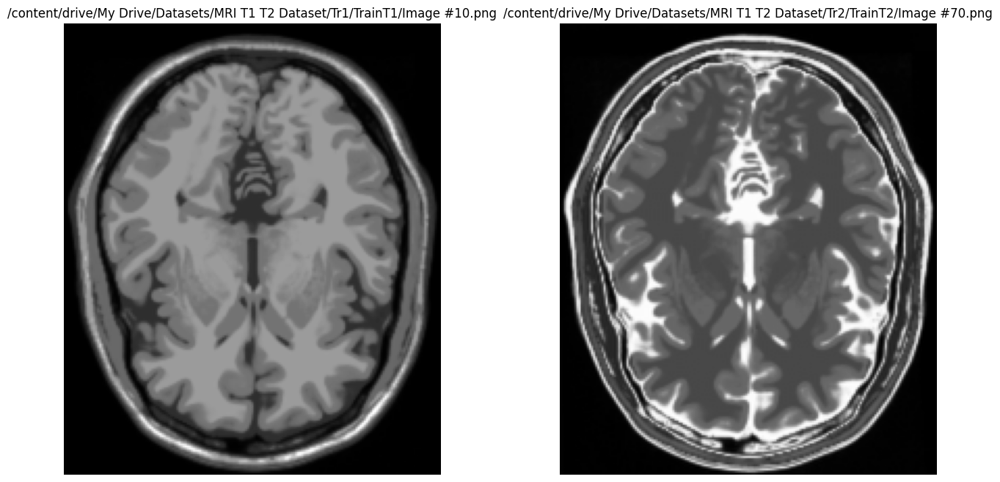

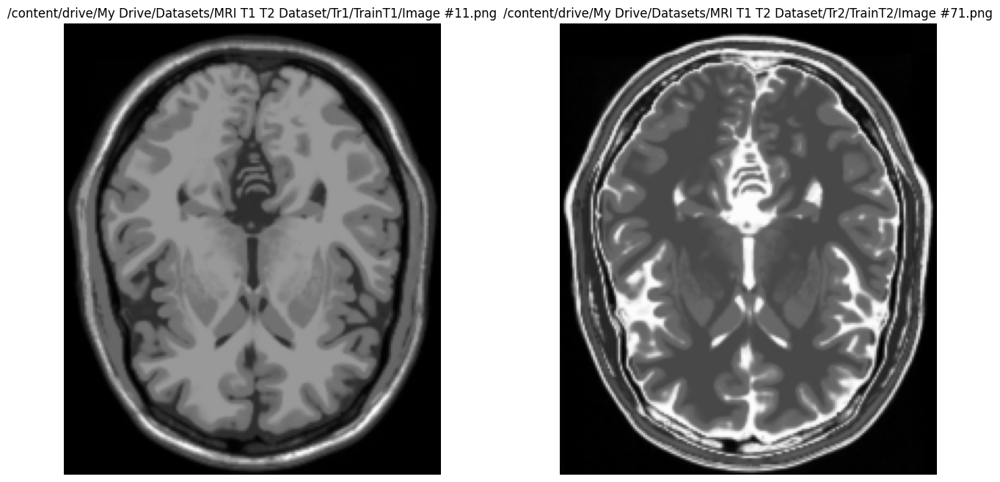

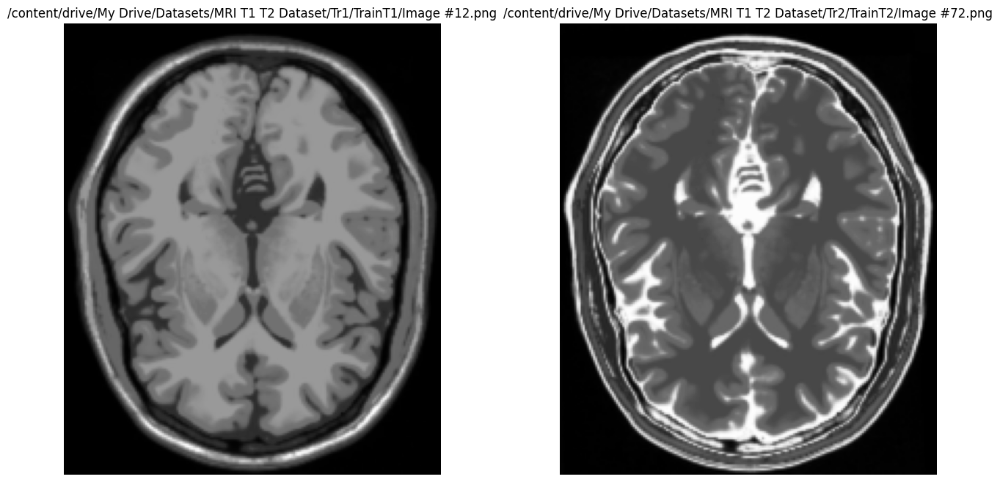

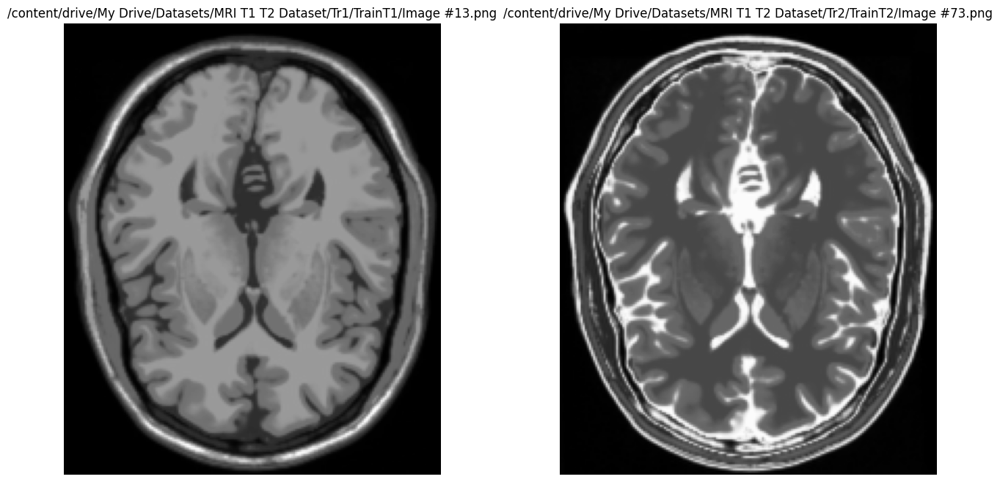

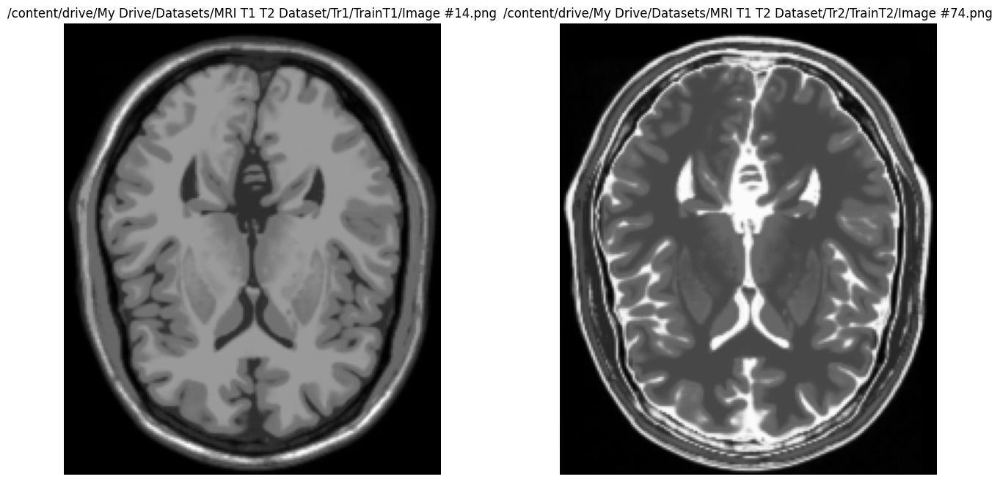

...

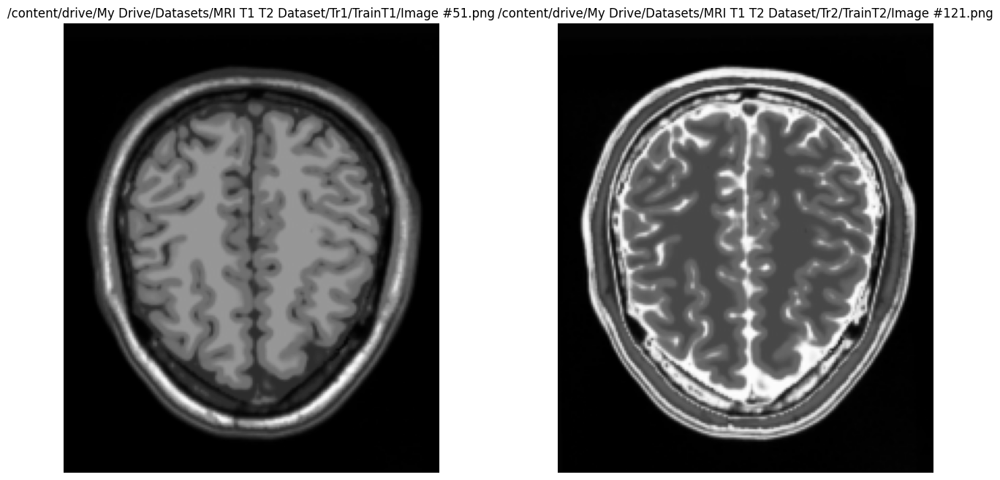

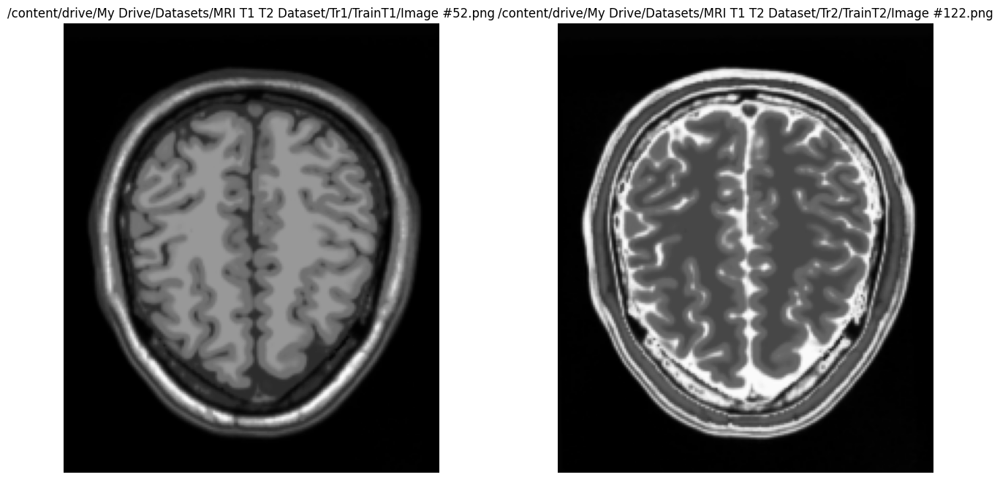

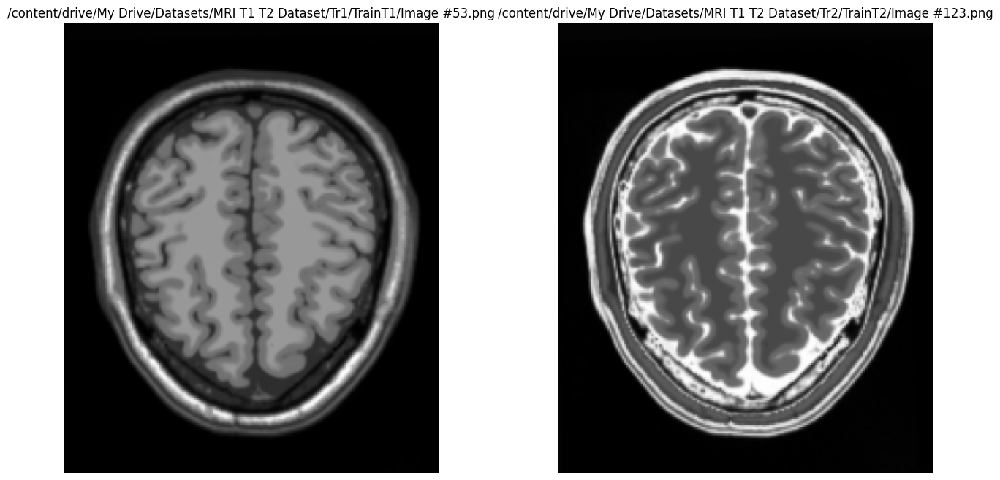

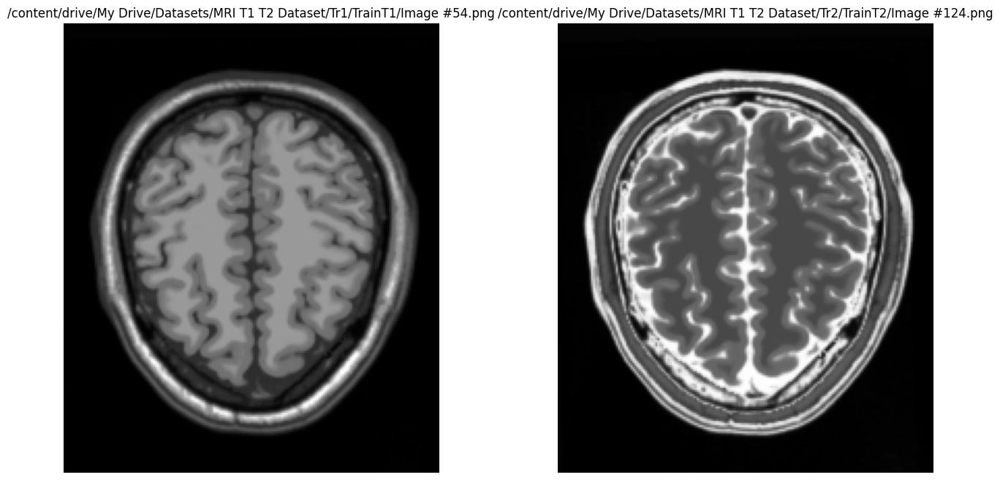

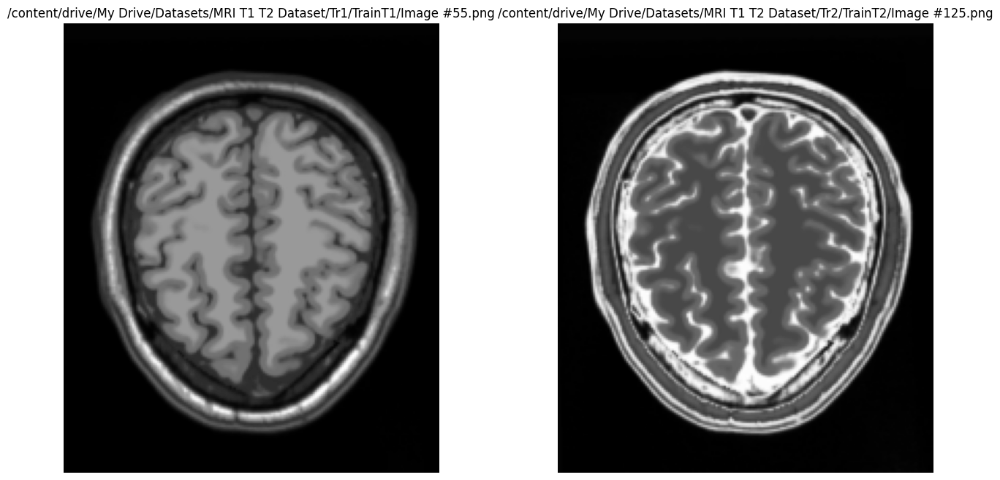

In [11]:
# use show_images function to show images
for i in range(43):
    show_images(images, i)

## Image Processing

In [12]:
BUFFER_SIZE = 1000
BATCH_SIZE = 1

In [13]:
# Convert to numpy array
tr1_data = np.asarray([img_to_array(load_img(image, target_size=(256,256))) for image in t1_images])
tr2_data = np.asarray([img_to_array(load_img(image, target_size=(256,256))) for image in t2_images])

In [14]:
# Convert to grayscale
tr1_data = tf.image.rgb_to_grayscale(tr1_data)
tr2_data = tf.image.rgb_to_grayscale(tr2_data)

In [15]:
# Convert to tensor
tr1= tf.data.Dataset.from_tensor_slices(tf.convert_to_tensor(tr1_data))
tr2= tf.data.Dataset.from_tensor_slices(tf.convert_to_tensor(tr2_data))

In [16]:
# normalizing the images to [-1, 1]
def normalize(image):
    image = tf.cast(image, tf.float32)
    image = tf.math.divide(image, 127.5)
    image = tf.math.subtract(image, 1.0)
    return image

In [17]:
def preprocess_image_train(image):
    image = tf.image.random_flip_left_right(image)
    image = normalize(image)   
    return image

In [18]:
AUTOTUNE = tf.data.experimental.AUTOTUNE
tr1 = tr1.map(preprocess_image_train, num_parallel_calls=AUTOTUNE).cache().batch(BATCH_SIZE)
tr2 = tr2.map(preprocess_image_train, num_parallel_calls=AUTOTUNE).cache().batch(BATCH_SIZE)

In [19]:
sample_tr1 = next(iter(tr1))
sample_tr2 = next(iter(tr2))

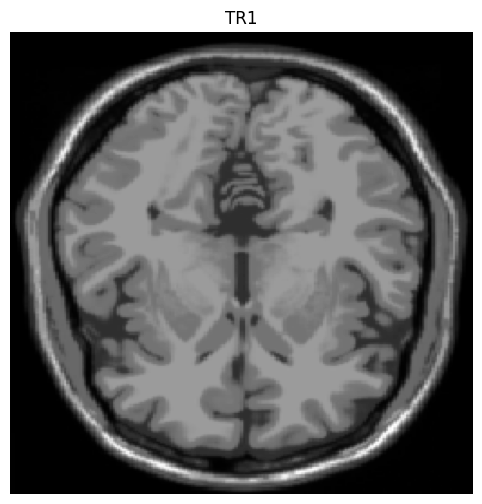

In [20]:
plt.figure(figsize=(12, 6))
plt.title('TR1')
plt.imshow(sample_tr1[0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')
plt.axis('off')
plt.show()

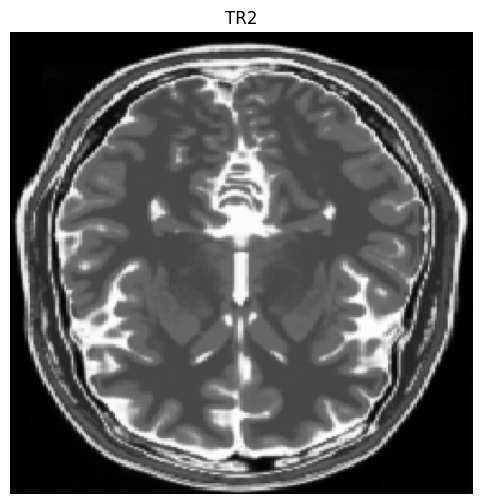

In [21]:
plt.figure(figsize=(12, 6))
plt.title('TR2')
plt.imshow(sample_tr2[0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')
plt.axis('off')
plt.show()

## Model Building

In [22]:
# Helper functions
class InstanceNormalization(tf.keras.layers.Layer):
    def __init__(self, epsilon=1e-5):
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon
    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)
    def call(self, x):
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(tf.math.add(variance, self.epsilon))
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same', kernel_initializer=initializer, use_bias=False)) # type: ignore
    if apply_norm:
        result.add(InstanceNormalization())
    result.add(tf.keras.layers.LeakyReLU())
    return result

def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same', kernel_initializer=initializer, use_bias=False)) # type: ignore
    result.add(InstanceNormalization())
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    result.add(tf.keras.layers.ReLU())
    return result

### Generator

In [23]:
def unet_generator():
    # A stack of downsample models
    down_stack = [
      downsample(64, 4, apply_norm=False), 
      downsample(128, 4), 
      downsample(256, 4),  
      downsample(512, 4),  
      downsample(512, 4), 
      downsample(512, 4),  
      downsample(512, 4),  
      downsample(512, 4),  
    ]

    # A stack of upsample models
    up_stack = [
      upsample(512, 4, apply_dropout=True),  
      upsample(512, 4, apply_dropout=True),  
      upsample(512, 4, apply_dropout=True),  
      upsample(512, 4),  
      upsample(256, 4),  
      upsample(128, 4),  
      upsample(64, 4),  
    ]
        
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2, padding='same', kernel_initializer=initializer, activation='tanh')  # type: ignore
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[None, None, 1])
    x = inputs
    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

In [24]:
# Initialise the generators
generator_g = unet_generator()
generator_f = unet_generator()

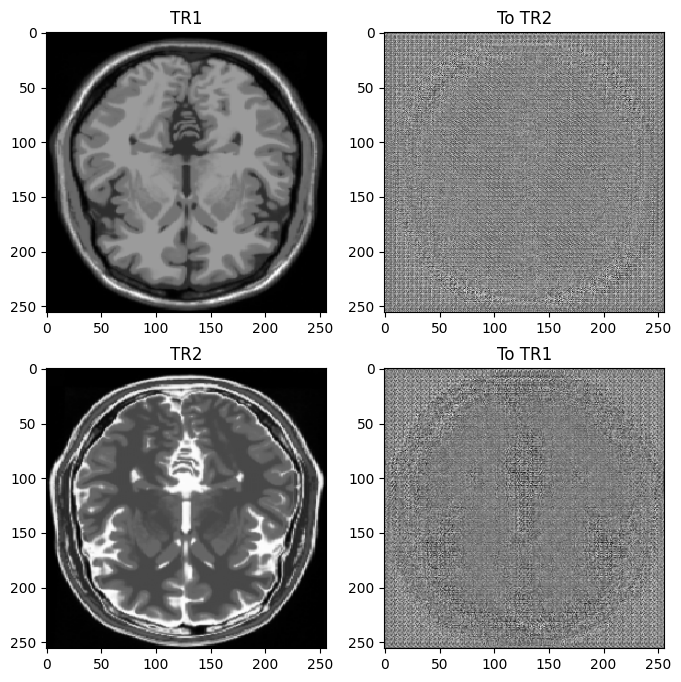

In [25]:
to_tr2 = generator_g(sample_tr1)
to_tr1 = generator_f(sample_tr2)
plt.figure(figsize=(8, 8))
contrast = 8

imgs = [sample_tr1, to_tr2, sample_tr2, to_tr1]
title = ['TR1', 'To TR2', 'TR2', 'To TR1']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    if i % 2 == 0:
        plt.imshow(imgs[i][0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')
    else:
        plt.imshow(imgs[i][0].numpy()[:, :, 0] * 0.5 * contrast + 0.5, cmap='gray')
plt.show()

### Discriminator

In [26]:
def discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    inp = tf.keras.layers.Input(shape=[None, None, 1], name='input_image')
    x = inp
    down1 = downsample(64, 4,  False)(x)
    down2 = downsample(128, 4)(down1)
    down3 = downsample(256, 4)(down2)
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)
    conv = tf.keras.layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer, use_bias=False)(zero_pad1) # type: ignore
    norm1 = InstanceNormalization()(conv)
    leaky_relu = tf.keras.layers.LeakyReLU()(norm1)
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)
    last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2) # type: ignore
  
    return tf.keras.Model(inputs=inp, outputs=last) # Create the model using input & output layer

In [27]:
# Initialise the discriminators
discriminator_x = discriminator()
discriminator_y = discriminator()

## Loss Functions

In [28]:
LAMBDA = 10

In [29]:
# Using Binary Crossentropy with logits true
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [30]:
# Calculating Discriminator loss by summing the real and generated
def discriminator_loss(real, generated):
    real_loss = loss_obj(tf.ones_like(real), real)
    generated_loss = loss_obj(tf.zeros_like(generated), generated)
    total_disc_loss = tf.add(real_loss, generated_loss)
    return tf.multiply(total_disc_loss, 0.5)

In [31]:
def generator_loss(generated):
    return loss_obj(tf.ones_like(generated), generated)

In [32]:
def calc_cycle_loss(real_image, cycled_image):
    loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return LAMBDA * loss1

In [33]:
def identity_loss(real_image, same_image):
    loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return LAMBDA * 0.5 * loss

In [34]:
# Optimizer with learning rate 0.0001 for Generator and Discriminator
generator_g_optimizer = tf.keras.optimizers.Adam(0.0001, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(0.0001, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(0.0001, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(0.0001, beta_1=0.5)

## Model Training

In [35]:
EPOCHS = 25

In [36]:
checkpoint_path = './checkpoints'  
ckpt = tf.train.Checkpoint(generator_g=generator_g, generator_f=generator_f, discriminator_x=discriminator_x, discriminator_y=discriminator_y, generator_g_optimizer=generator_g_optimizer, generator_f_optimizer=generator_f_optimizer, discriminator_x_optimizer=discriminator_x_optimizer, discriminator_y_optimizer=discriminator_y_optimizer)
ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=EPOCHS)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Latest checkpoint restored!!')

In [37]:
def generate_images(model, test_input, expected_output):
    prediction = model(test_input)
    plt.figure(figsize=(10, 10))
    display_list = [test_input[0], prediction[0], expected_output[0]]
    title = ['Input Image', 'Predicted Image', 'Expected Image']
    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        # getting the pixel values between [0, 1] to plot it.
        plt.imshow(display_list[i].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')
        plt.axis('off')
    plt.show()

In [38]:
@tf.function
def train_step(real_x, real_y):
    # Persistent is set to True because the tape is used more than once to calculate the gradients.
    with tf.GradientTape(persistent=True) as tape:
        # Generator G translates X -> Y
        # Generator F translates Y -> X.
        fake_y = generator_g(real_x, training=True)  # Generate images using Generator_g on real_x
        cycled_x = generator_f(fake_y, training=True) # Generate images susiing Generator_f on fake_y
        
        fake_x =  generator_f(real_y, training=True) # Generate images using Generator_f on real_y
        cycled_y = generator_g(fake_x, training=True) # Generate images using Generator_g on fake_x
        
        # same_x and same_y are used for identity loss.
        same_x = generator_f(real_x, training=True) # Generate images using Generator_f on real_x
        same_y = generator_g(real_y, training=True) # Generate images using Generator_g on real_y
        
        disc_real_x =  discriminator_x(real_x, training=True) # Discriminate images using Discriminator_x on real_x
        disc_real_y = discriminator_y(real_y, training=True) # Discriminate images using Discriminator_y on real_y
        
        disc_fake_x = discriminator_x(fake_x, training=True) # Discriminate images using Discriminator_x on fake_x
        disc_fake_y = discriminator_y(fake_y, training=True) # Discriminate images using Discriminator_y on fake_y
        
        # Calculate the loss
        gen_g_loss = generator_loss(disc_fake_y) # calculate the generator_loss for disc_fake_
        gen_f_loss = generator_loss(disc_fake_x) # calculate the generator_loss for disc_fake_X 
        
        # Calculate the total cycle loss
        total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)
        
        # Total generator loss = adversarial loss + cycle loss
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)
        
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x) # Discriminator_loss for disc_fake_x wrt disc_real_x
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y) # Discriminator_loss foor disc_fake_y wrt disc_real_y
        
    # Calculate the gradients for Generator and Discriminator
    generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
    generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)
    
    discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
    discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)
    
    # Apply the gradients to the optimizer
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))

    discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
    discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))


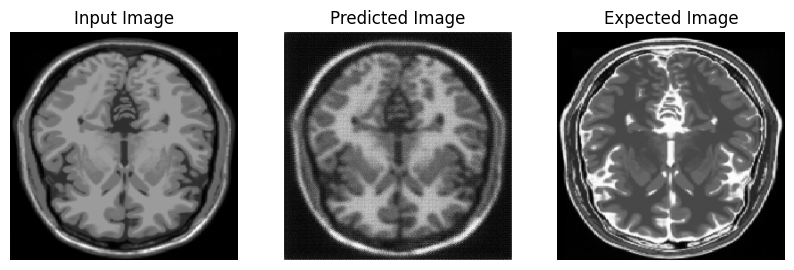

Epoch 0 completed..


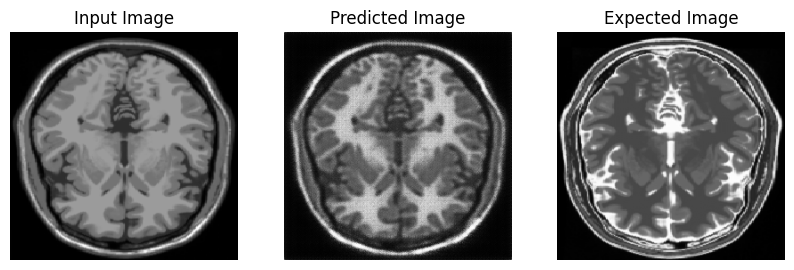

Epoch 1 completed..


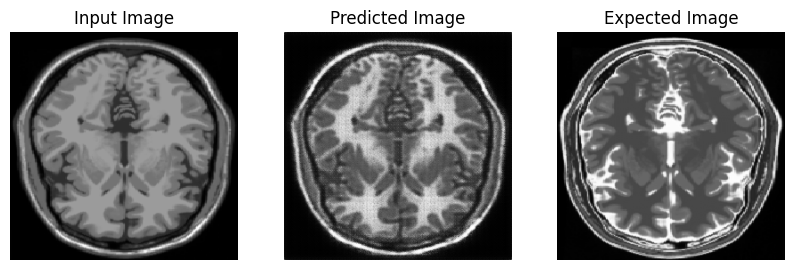

Epoch 2 completed..


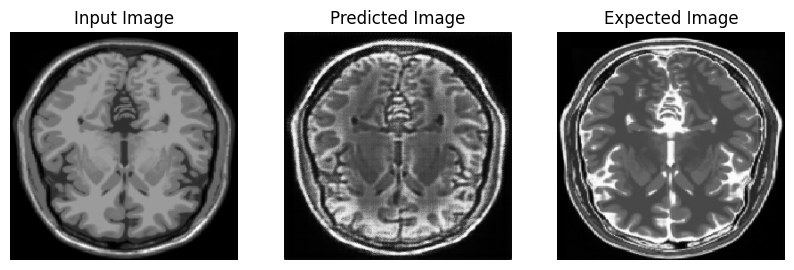

Epoch 3 completed..


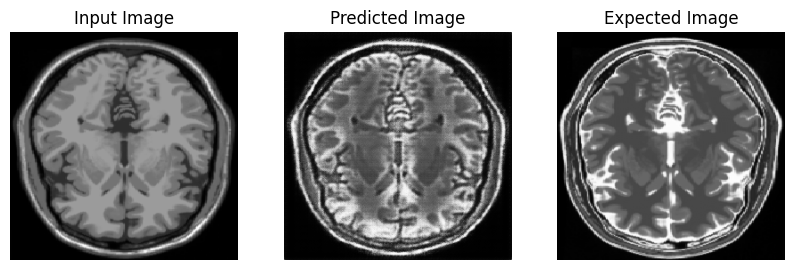

Epoch 4 completed..


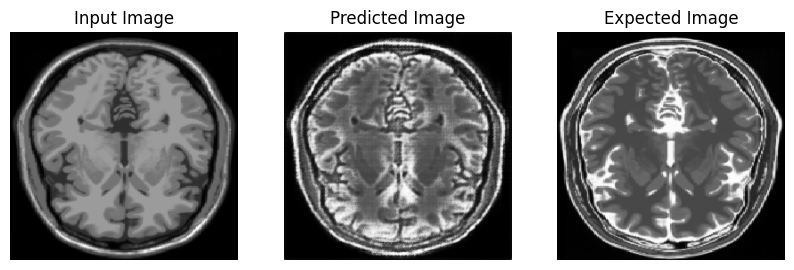

Epoch 5 completed..


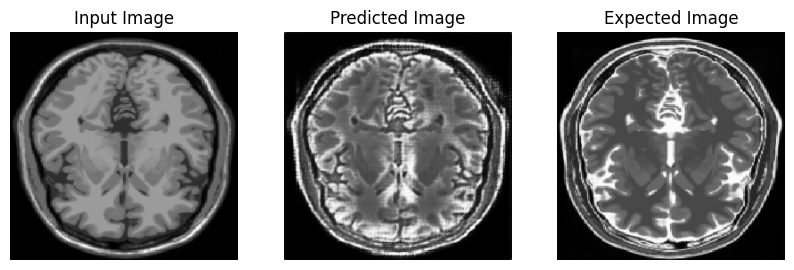

Epoch 6 completed..


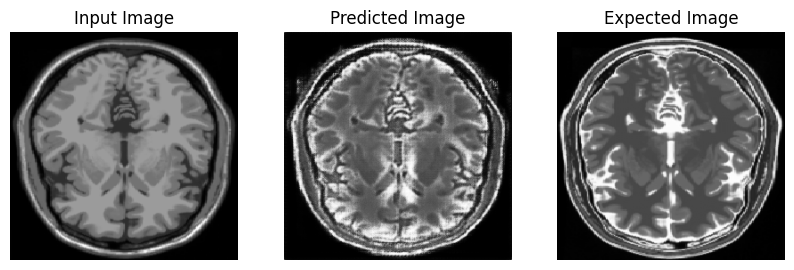

Epoch 7 completed..


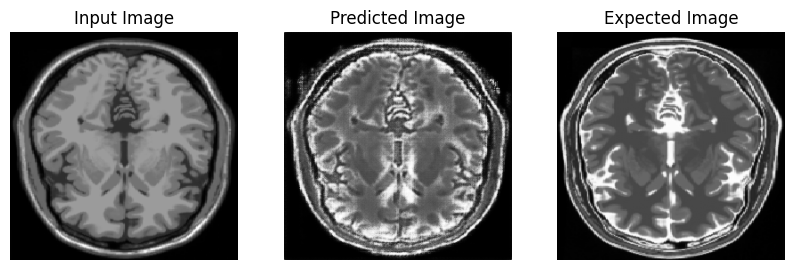

Epoch 8 completed..


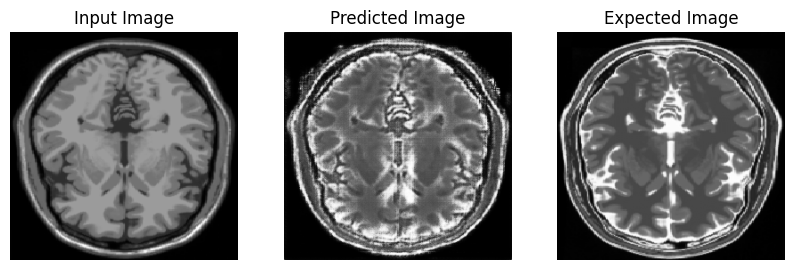

Epoch 9 completed..


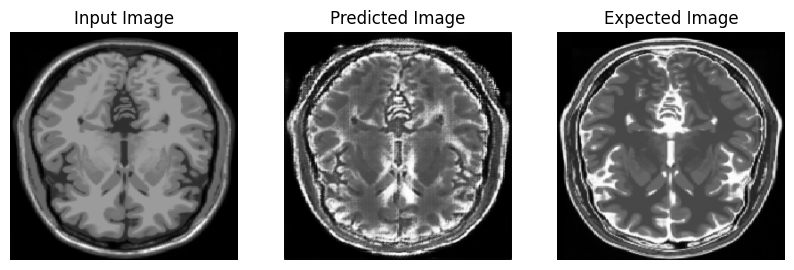

Epoch 10 completed..


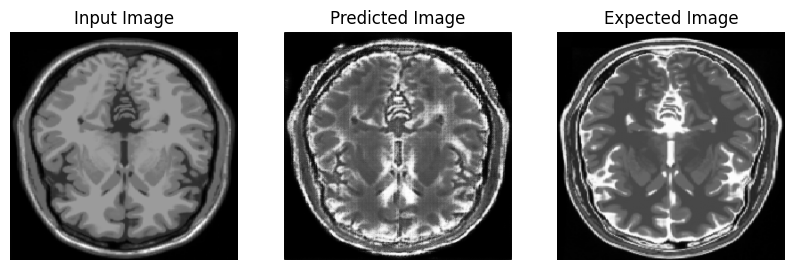

Epoch 11 completed..


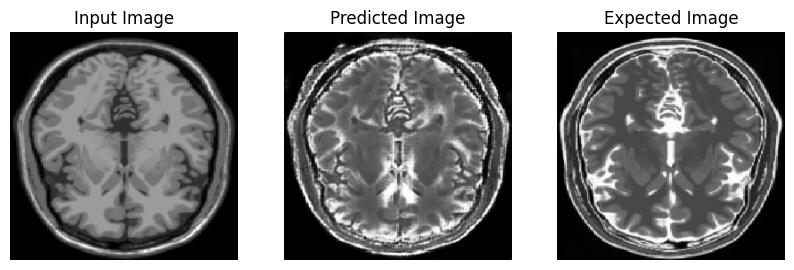

Epoch 12 completed..


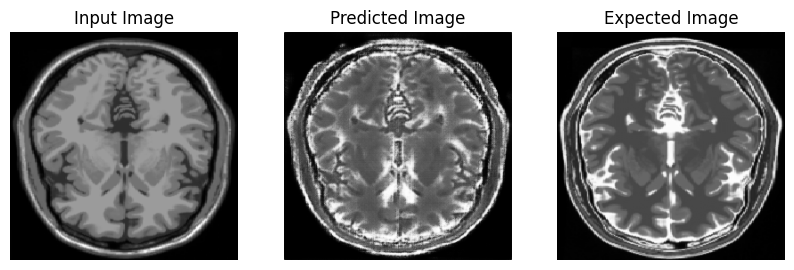

Epoch 13 completed..


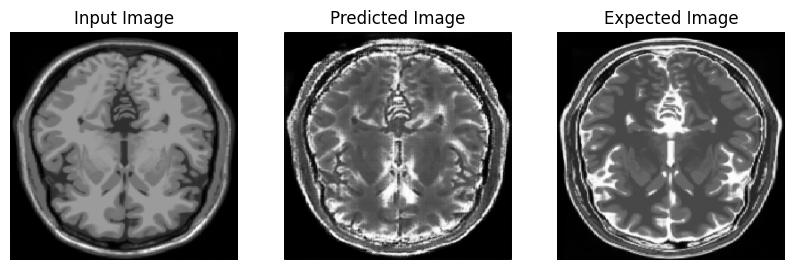

Epoch 14 completed..


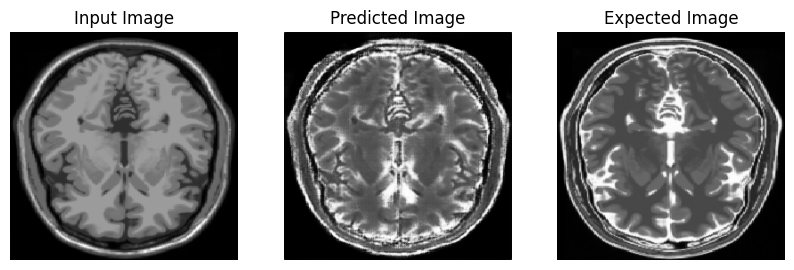

Epoch 15 completed..


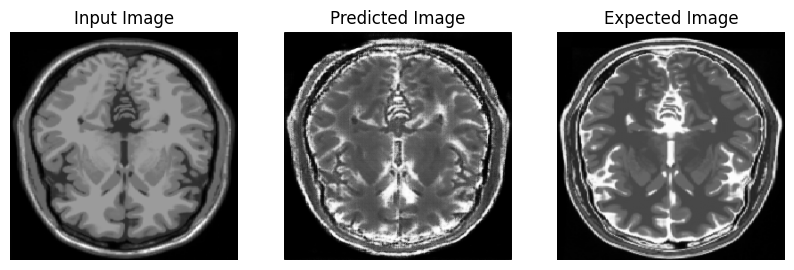

Epoch 16 completed..


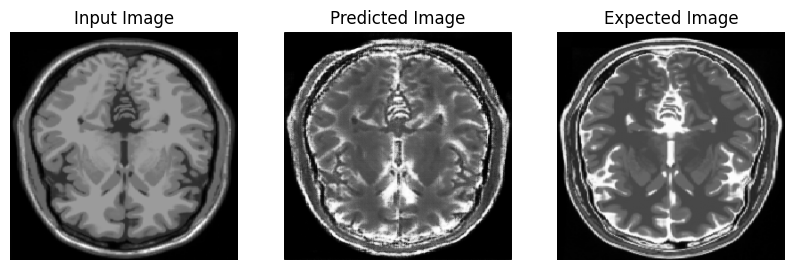

Epoch 17 completed..


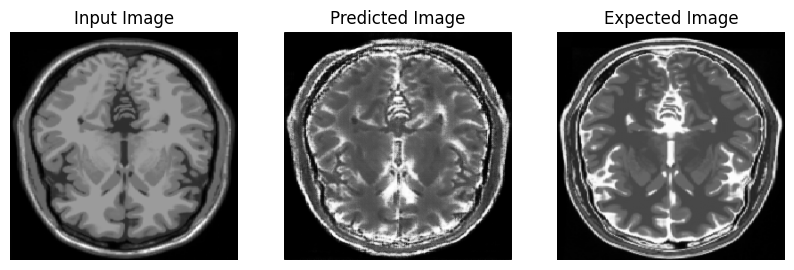

Epoch 18 completed..


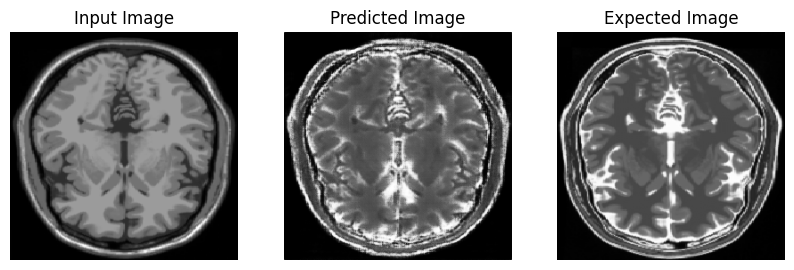

Epoch 19 completed..


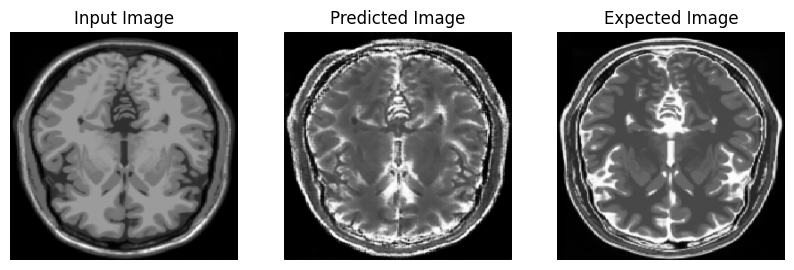

Epoch 20 completed..


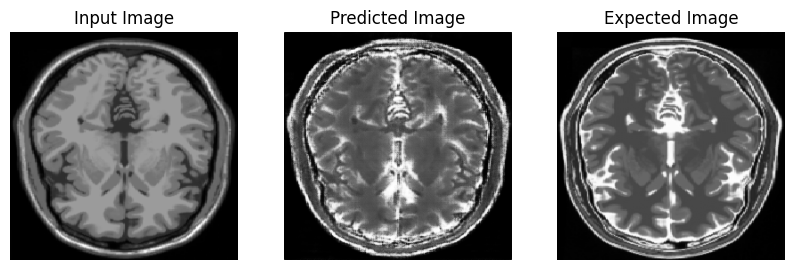

Epoch 21 completed..


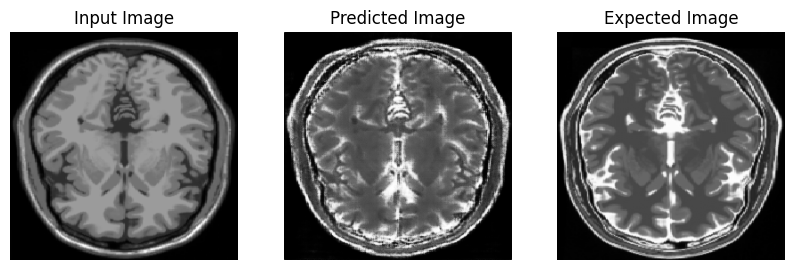

Epoch 22 completed..


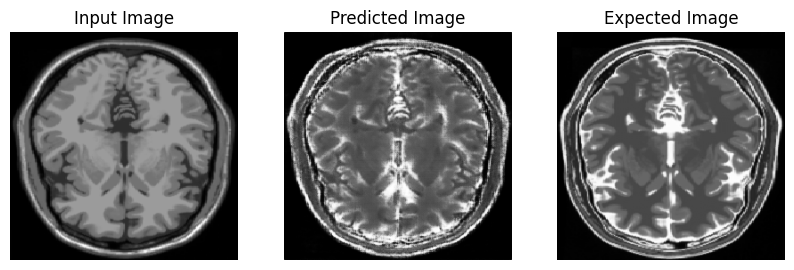

Epoch 23 completed..


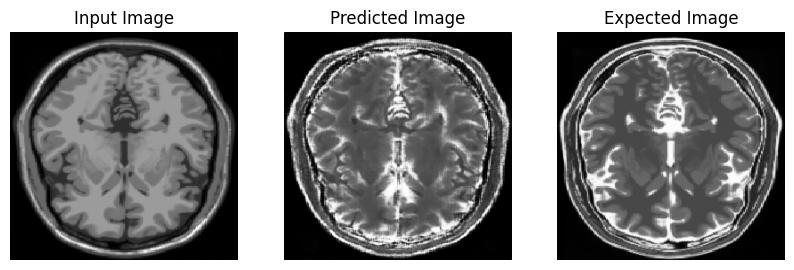

Epoch 24 completed..


In [39]:
for epoch in range(EPOCHS):
    for image_x, image_y in tf.data.Dataset.zip((tr1, tr2)):
        train_step(image_x, image_y)
    generate_images(generator_g, sample_tr1, sample_tr2)
    # ckpt_save_path = ckpt_manager.save()
    # print('Epoch', epoch, '• Checkpoint:', ckpt_save_path)
    print('Epoch', epoch, 'completed..')

## Evaluation

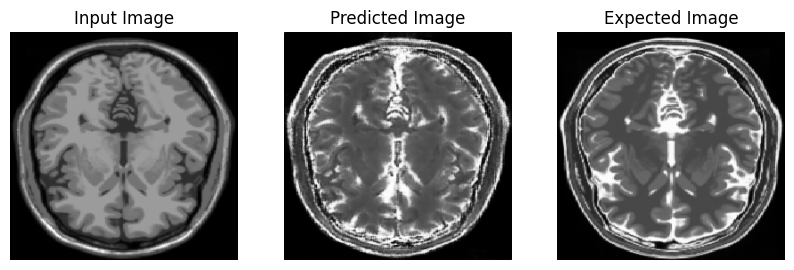

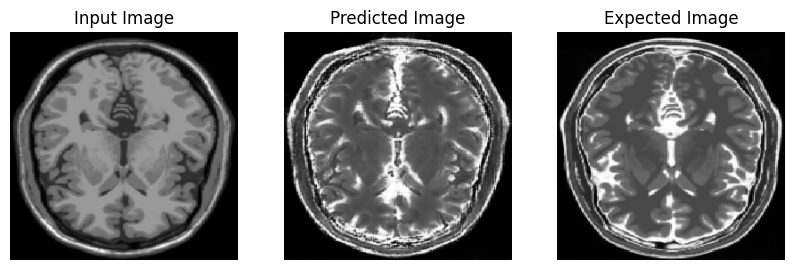

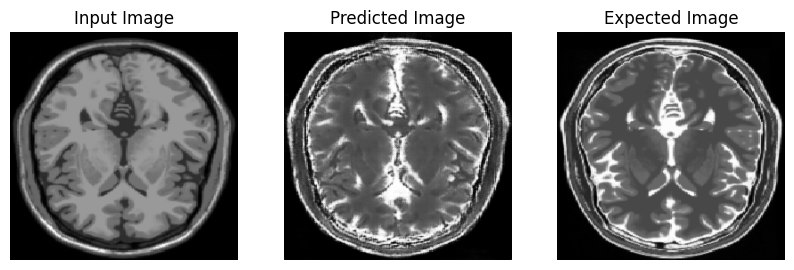

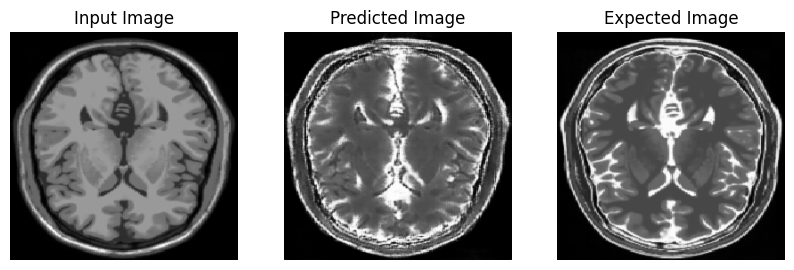

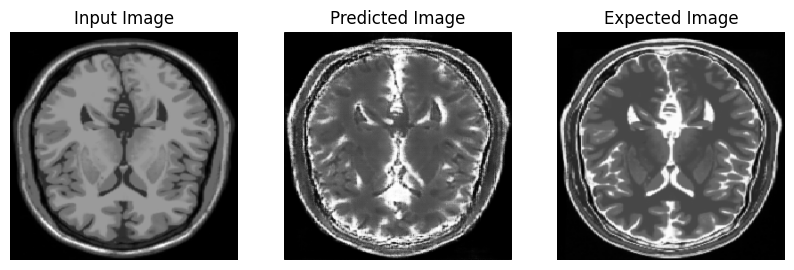

...

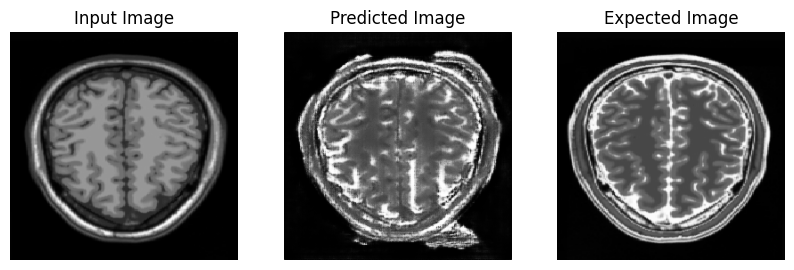

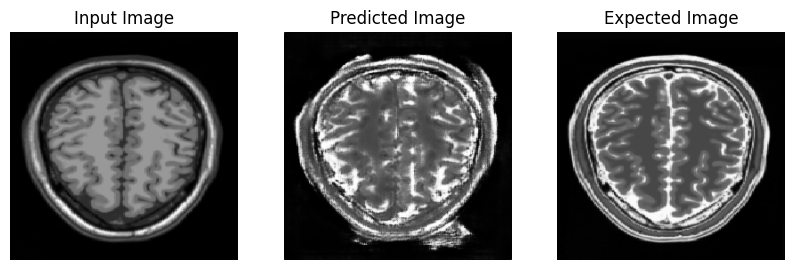

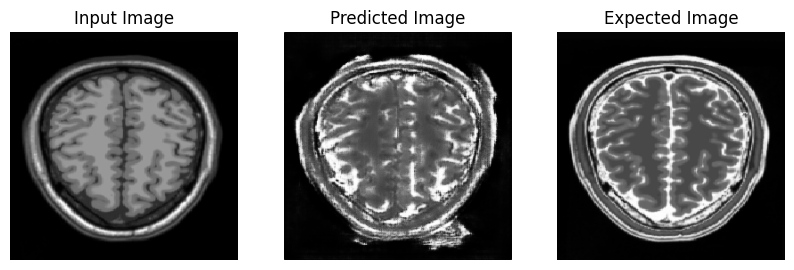

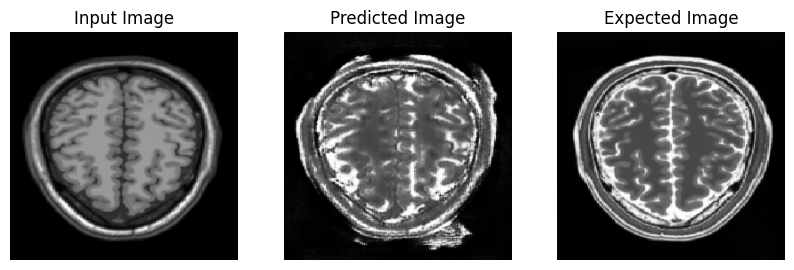

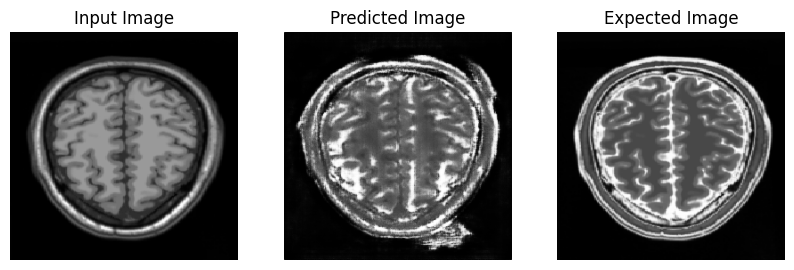

In [45]:
tr2_iterator = iter(tr2)
for inp in tr1:
  exp = next(tr2_iterator)
  generate_images(generator_g, inp, exp)